<a href="https://colab.research.google.com/github/PrasannaMadiwar/Nuclear_reactor_fault_prediction/blob/main/Reactor.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv("/content/Nuclear_Power_Plant_CPS_Dataset.csv")

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Timestamp                 1200 non-null   object 
 1   Reactor Temp (°C)         1200 non-null   float64
 2   Coolant Flow Rate (L/s)   1200 non-null   float64
 3   Pressure (MPa)            1200 non-null   float64
 4   Radiation Level (μSv/h)   1200 non-null   float64
 5   Turbine Speed (RPM)       1200 non-null   float64
 6   Pump Status               1200 non-null   object 
 7   Power Output (MW)         1200 non-null   float64
 8   Control Rod Position (%)  1200 non-null   float64
 9   Steam Flow Rate (kg/s)    1200 non-null   float64
 10  Vibration Level (mm/s)    1200 non-null   float64
 11  Water Level (m)           1200 non-null   float64
 12  Anomaly Detected          1200 non-null   object 
dtypes: float64(10), object(3)
memory usage: 122.0+ KB


In [4]:
df.sample(10)

,Timestamp,Reactor Temp (°C),Coolant Flow Rate (L/s),Pressure (MPa),Radiation Level (μSv/h),Turbine Speed (RPM),Pump Status,Power Output (MW),Control Rod Position (%),Steam Flow Rate (kg/s),Vibration Level (mm/s),Water Level (m),Anomaly Detected
1061,2024-10-17 03:41:00,307.271861,476.064421,16.948644,0.515035,3445.606042,OFF,1103.888879,67.708885,191.954025,1.939751,5.360702,No
999,2024-10-17 02:39:00,358.588742,477.318084,15.797801,0.993058,3070.127036,ON,1120.938889,75.251598,244.352938,2.093504,5.137003,No
817,2024-10-16 23:37:00,363.344462,439.942065,15.737776,0.015131,3134.797501,ON,1006.277429,75.253871,235.835414,2.711211,5.050480,No
1129,2024-10-17 04:49:00,354.931436,482.736532,15.474345,0.605803,3280.654913,ON,1046.283838,60.370111,237.377080,1.730637,5.215465,Yes
302,2024-10-16 15:02:00,361.209404,457.727017,17.006135,1.100721,3249.665029,OFF,1034.410265,66.021724,194.482893,1.360176,5.232691,No
779,2024-10-16 22:59:00,359.310081,476.105784,16.257814,0.367050,3203.136447,ON,1058.920966,67.461416,226.507529,2.202925,5.410694,No
562,2024-10-16 19:22:00,363.066871,471.131505,15.735511,0.519406,3212.376671,OFF,1086.284690,77.960124,234.019821,2.185434,5.222706,No
381,2024-10-16 16:21:00,341.009110,487.229560,15.675117,1.092184,3110.735897,OFF,909.536614,75.644237,210.801822,1.857157,5.117871,No
25,2024-10-16 10:25:00,351.663839,468.052690,16.257127,0.315632,3248.248050,OFF,982.892567,69.889850,222.089794,1.923991,5.208534,No
973,2024-10-17 02:13:00,340.210640,472.276370,16.903598,0.424663,3032.781666,ON,1028.239455,72.700089,212.163779,2.047035,5.286903,No


In [5]:
df['Anomaly Detected'].value_counts()

,count
Anomaly Detected,
No,1138
Yes,62


In [6]:
df.describe()

,Reactor Temp (°C),Coolant Flow Rate (L/s),Pressure (MPa),Radiation Level (μSv/h),Turbine Speed (RPM),Power Output (MW),Control Rod Position (%),Steam Flow Rate (kg/s),Vibration Level (mm/s),Water Level (m)
count,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000
mean,350.575733,470.369775,16.008382,0.581900,3192.985499,1000.442858,70.123696,219.841024,1.990574,5.198914
std,14.825930,14.756203,0.511526,0.295586,201.808719,52.127700,4.996608,14.363382,0.500757,0.098022
min,301.380990,424.707318,14.504432,-0.353011,2620.097224,815.581735,50.816722,161.163996,0.312210,4.896601
25%,340.624931,460.370079,15.646462,0.386899,3061.261439,965.441255,66.845331,210.077114,1.661971,5.135156
50%,350.724549,470.184693,16.008505,0.593313,3192.707942,999.437283,70.100292,220.139668,1.975637,5.199864
75%,360.140211,480.089684,16.346386,0.777762,3326.666520,1036.376938,73.409052,229.360633,2.318087,5.264305
max,407.790972,517.896614,17.963119,1.572928,3822.582040,1155.884056,86.886915,263.711638,3.688884,5.528412


In [7]:
corr = df.corr(numeric_only=True)

<Axes: >

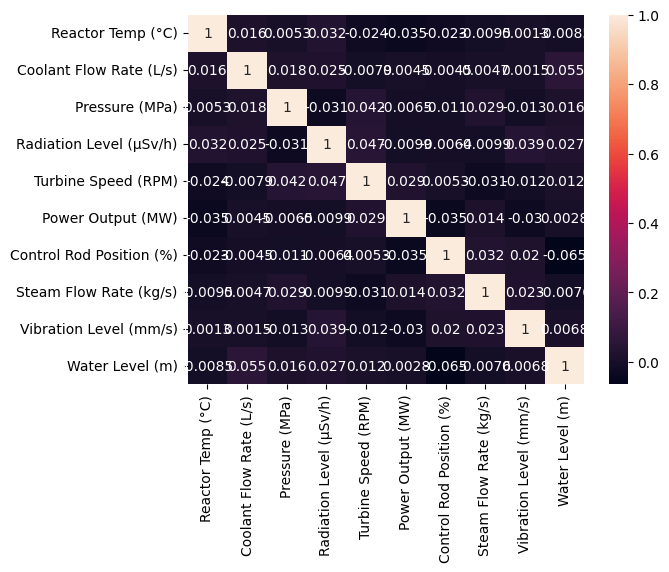

In [8]:
sns.heatmap(corr,annot=True)

In [9]:
df.isna().sum()

,0
Timestamp,0
Reactor Temp (°C),0
Coolant Flow Rate (L/s),0
Pressure (MPa),0
Radiation Level (μSv/h),0
Turbine Speed (RPM),0
Pump Status,0
Power Output (MW),0
Control Rod Position (%),0
Steam Flow Rate (kg/s),0


In [10]:
df['Timestamp'] = pd.to_datetime(df['Timestamp'])

In [11]:
from  sklearn.preprocessing import OrdinalEncoder

In [12]:
oe1 = OrdinalEncoder(categories=[['No','Yes']])
oe2 = OrdinalEncoder(categories=[['OFF','ON']])

In [13]:
df['Anomaly Detected'] = oe1.fit_transform(df[['Anomaly Detected']])
df['Pump Status'] = oe2.fit_transform(df[['Pump Status']])

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Timestamp                 1200 non-null   datetime64[ns]
 1   Reactor Temp (°C)         1200 non-null   float64       
 2   Coolant Flow Rate (L/s)   1200 non-null   float64       
 3   Pressure (MPa)            1200 non-null   float64       
 4   Radiation Level (μSv/h)   1200 non-null   float64       
 5   Turbine Speed (RPM)       1200 non-null   float64       
 6   Pump Status               1200 non-null   float64       
 7   Power Output (MW)         1200 non-null   float64       
 8   Control Rod Position (%)  1200 non-null   float64       
 9   Steam Flow Rate (kg/s)    1200 non-null   float64       
 10  Vibration Level (mm/s)    1200 non-null   float64       
 11  Water Level (m)           1200 non-null   float64       
 12  Anomaly Detected    

<Axes: >

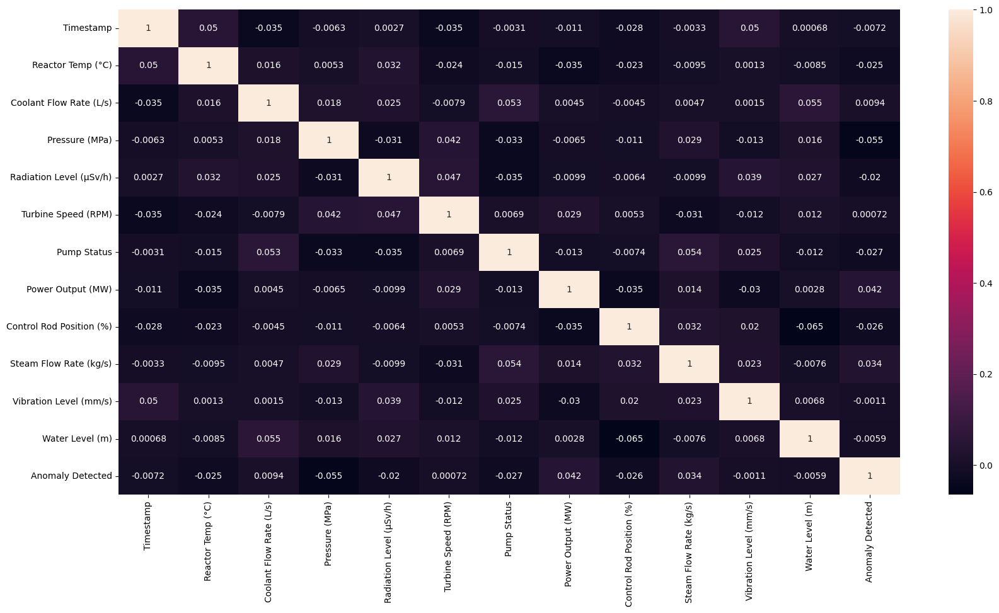

In [15]:
plt.figure(figsize=(20,10))
sns.heatmap(df.corr(),annot=True)

In [16]:
cat_col = ['Pump Status','Anomaly Detected']

In [17]:
num_col = df.drop(['Pump Status','Anomaly Detected'],axis=1)

In [18]:
for i in cat_col:
  print(df[i].value_counts())

Pump Status
1.0    982
0.0    218
Name: count, dtype: int64
Anomaly Detected
0.0    1138
1.0      62
Name: count, dtype: int64


/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


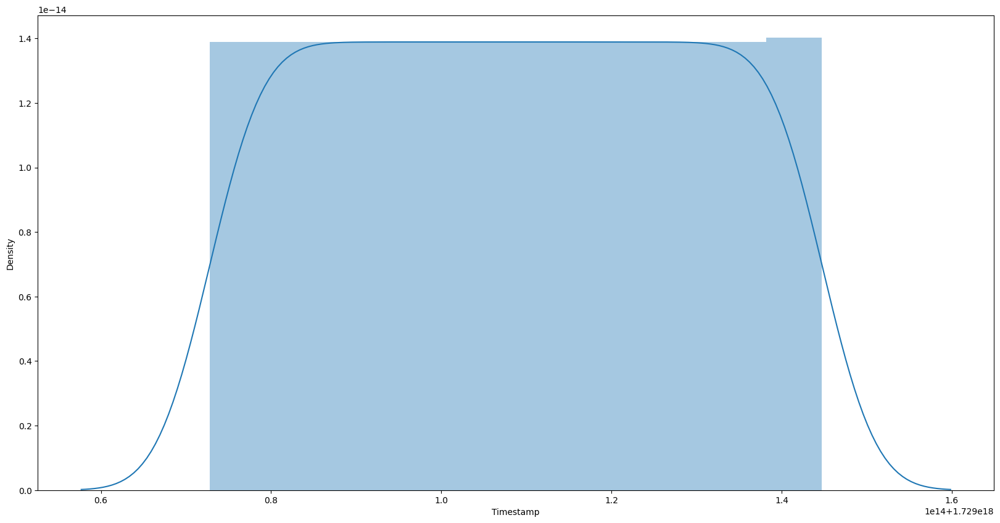

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


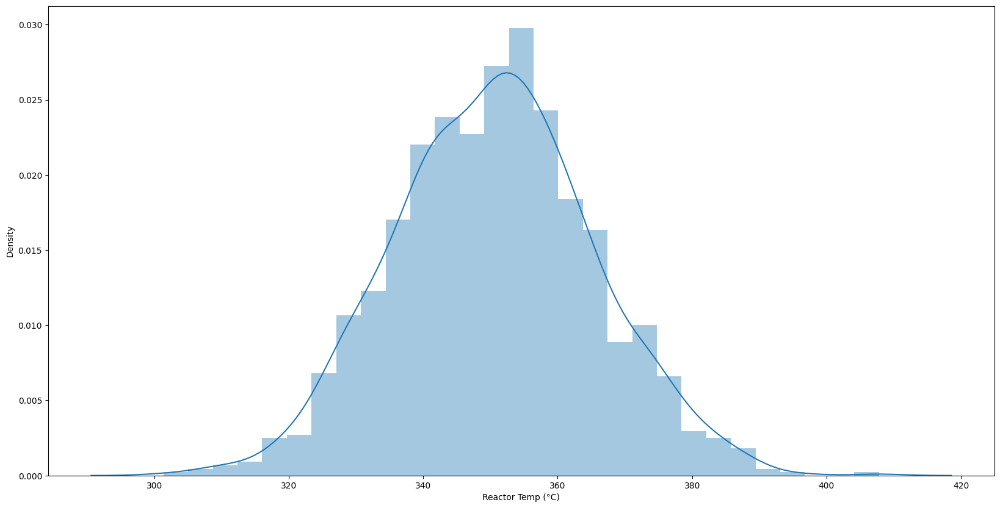

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


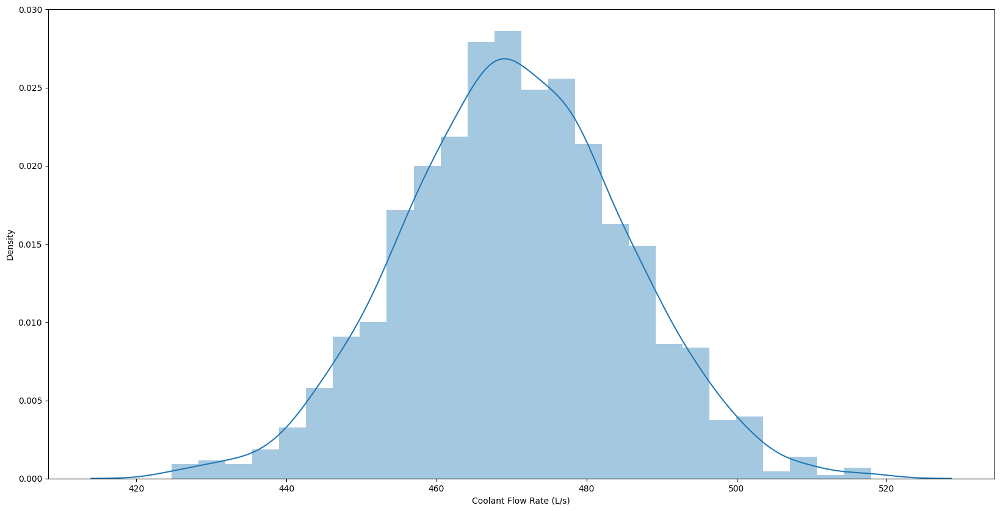

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


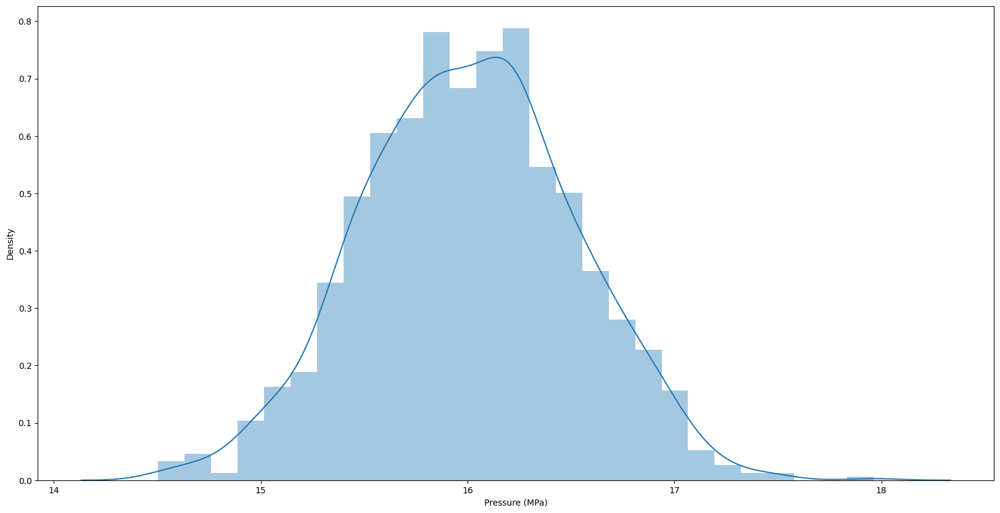

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


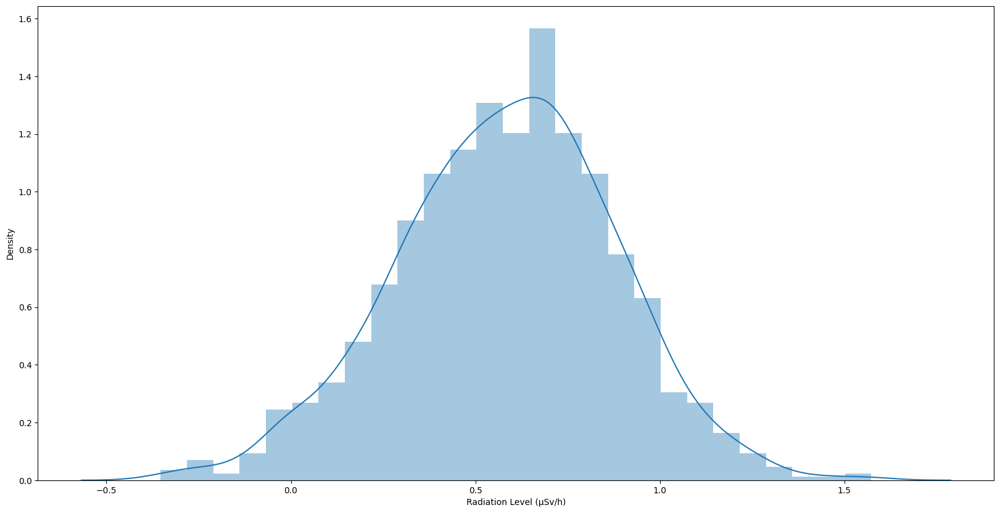

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


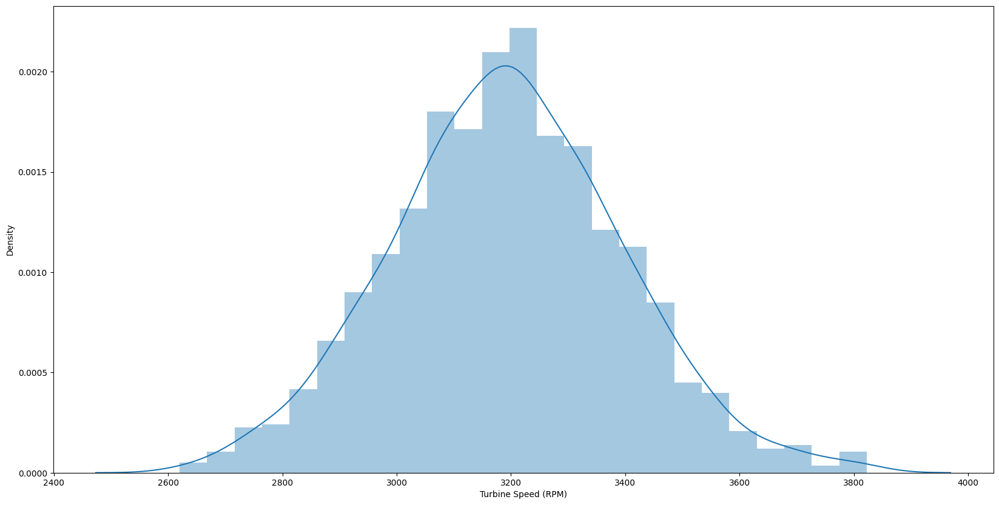

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


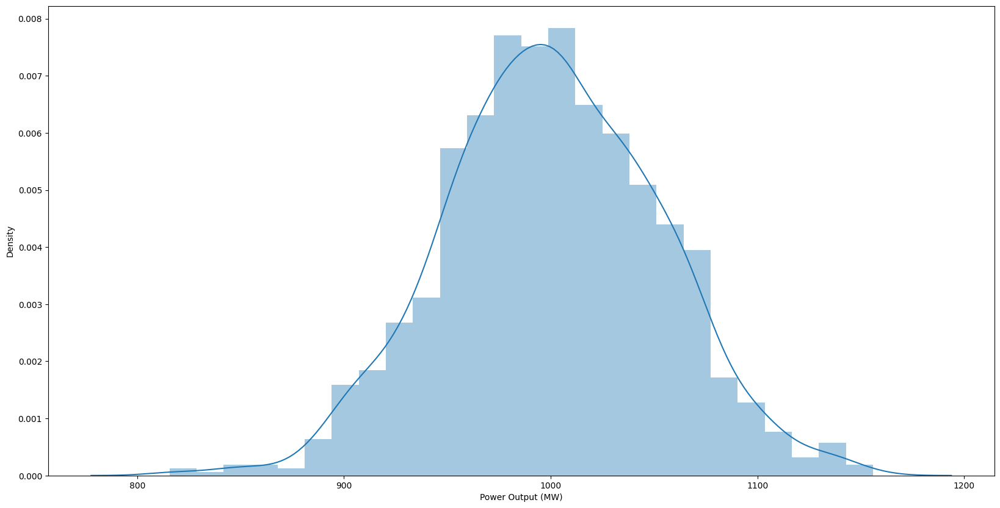

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


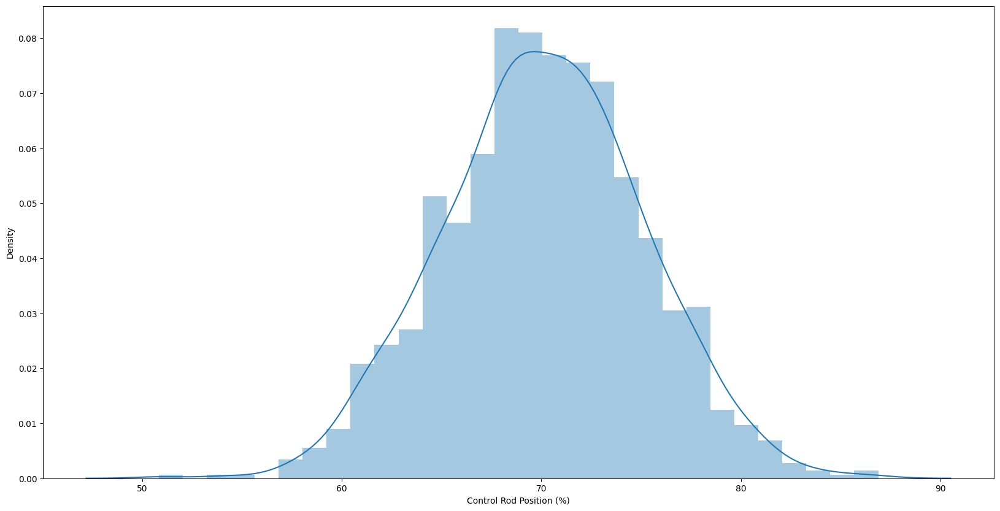

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


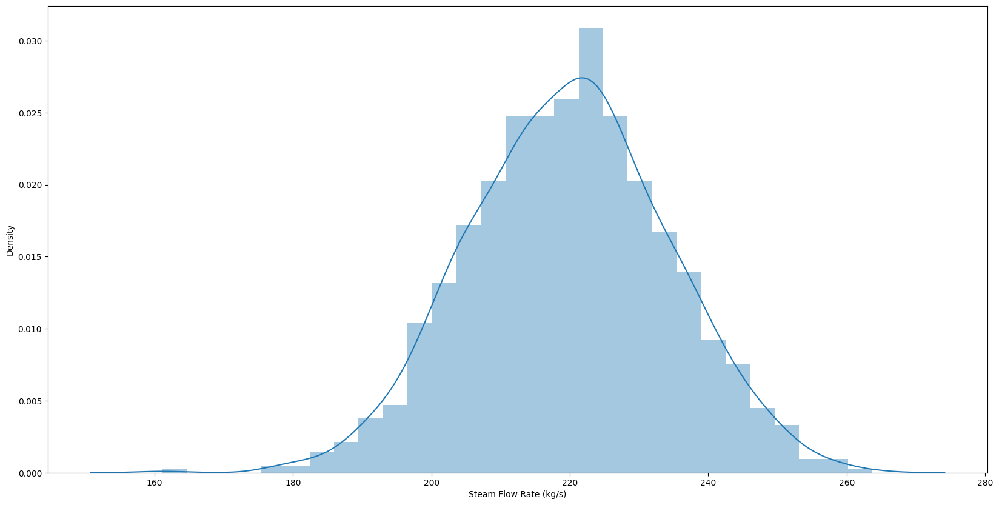

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


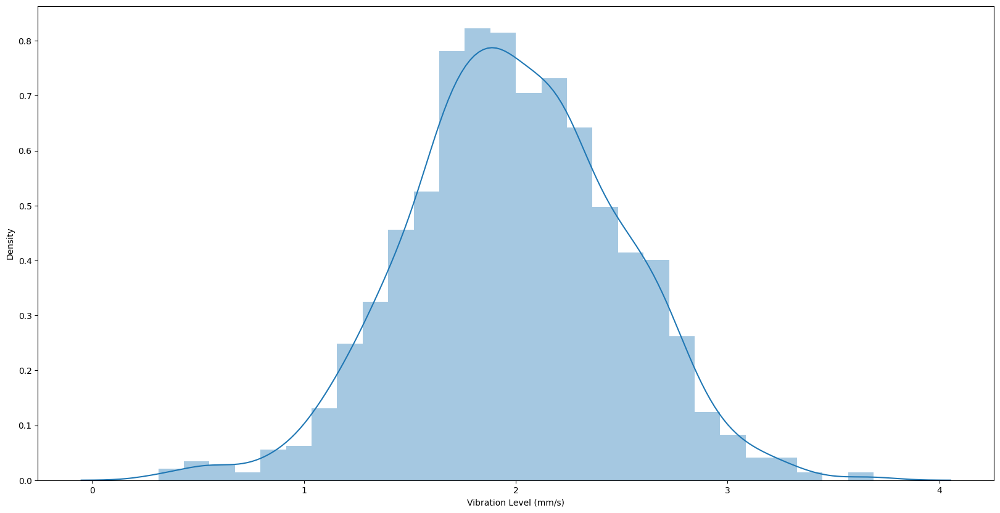

/tmp/ipython-input-1644883565.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col])


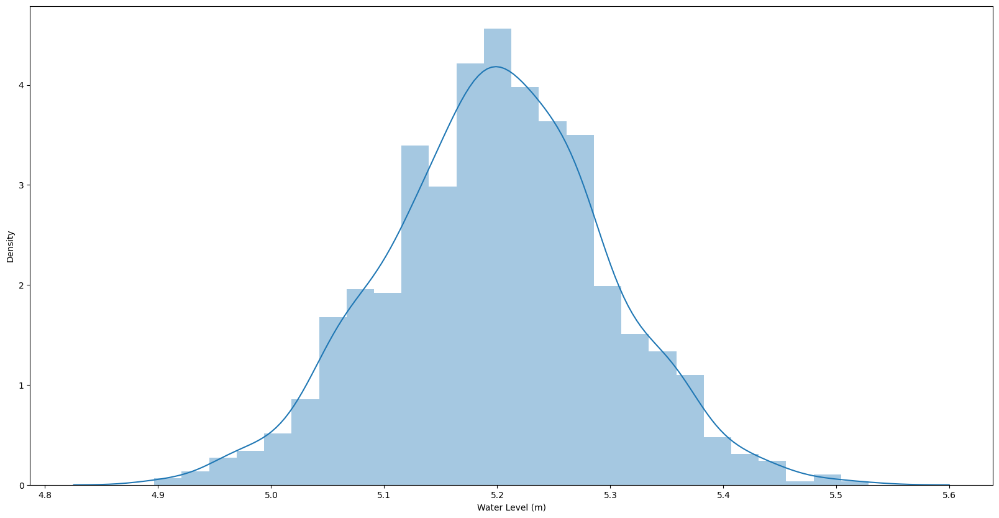

In [19]:
for col in num_col:
  plt.figure(figsize=(20,10))
  sns.distplot(df[col])
  plt.show()

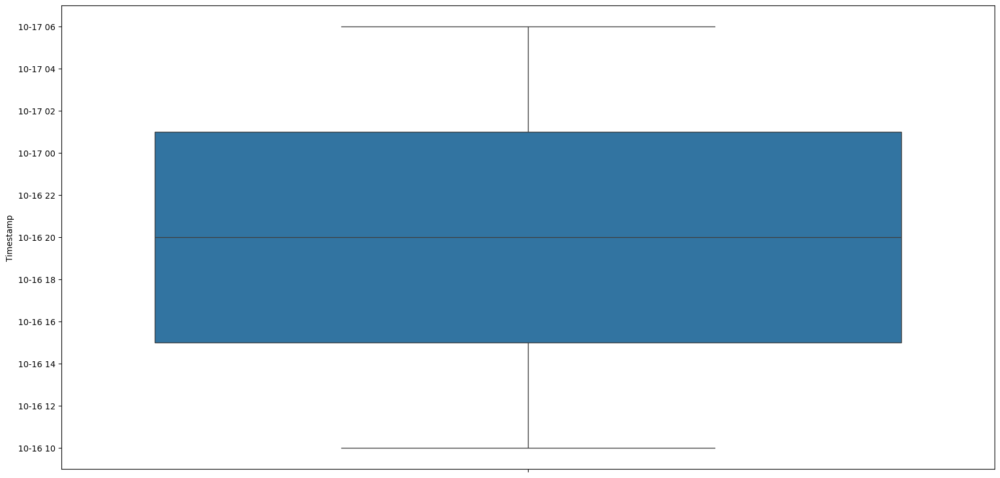

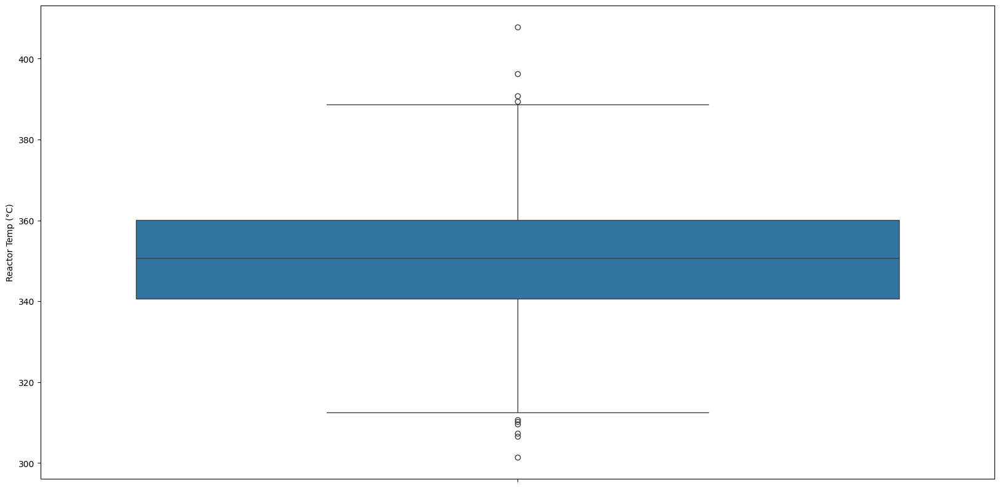

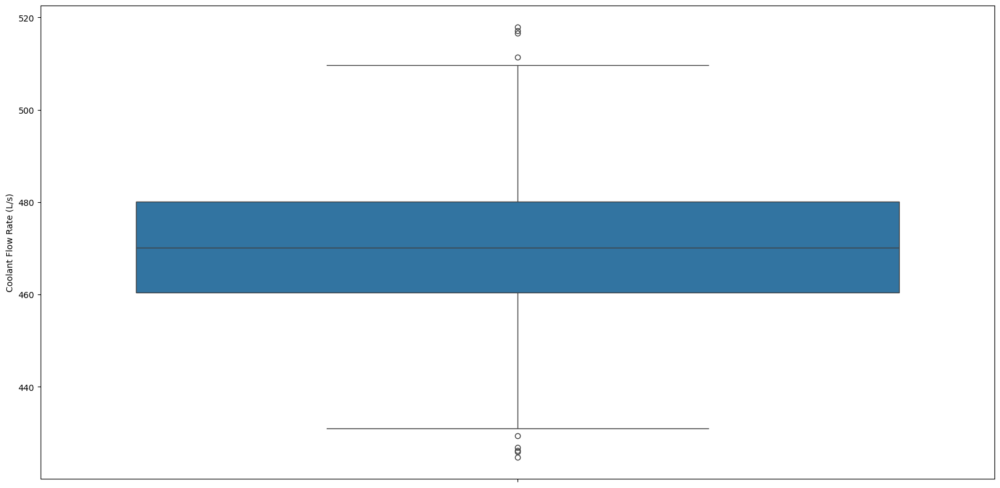

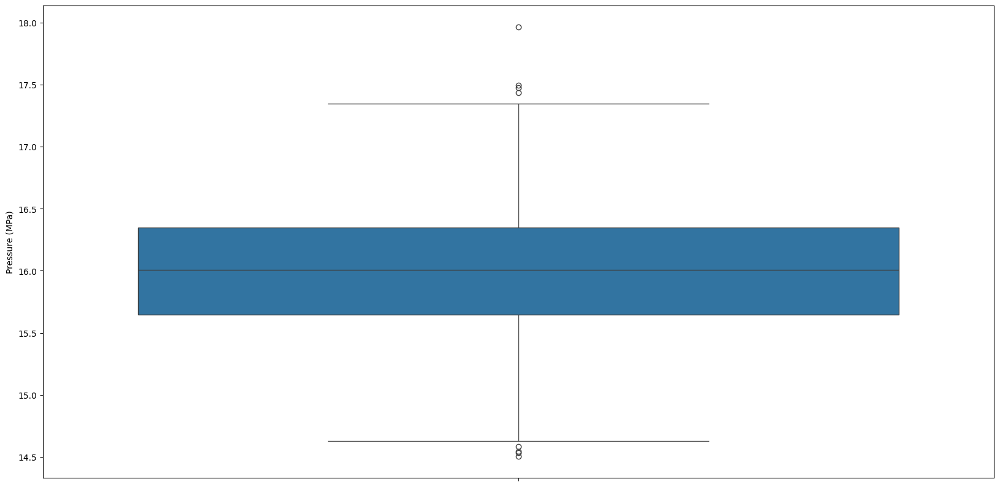

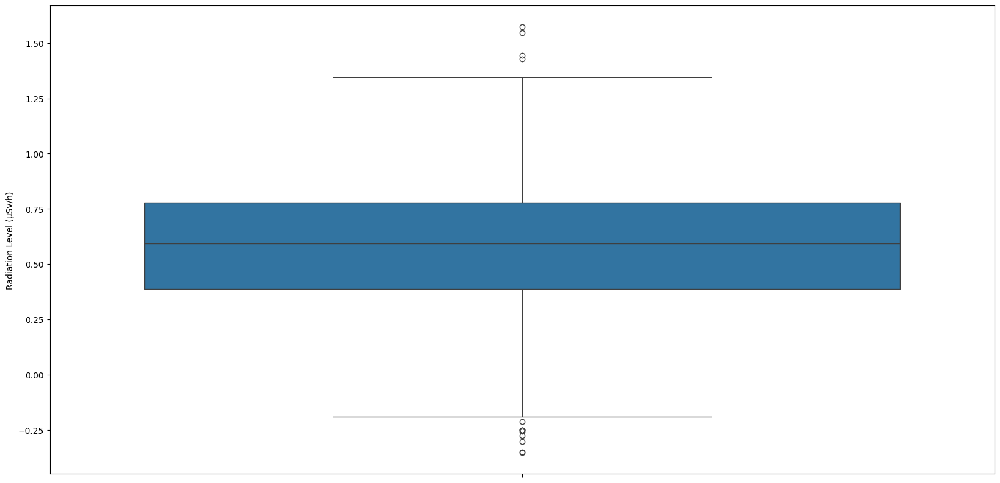

...

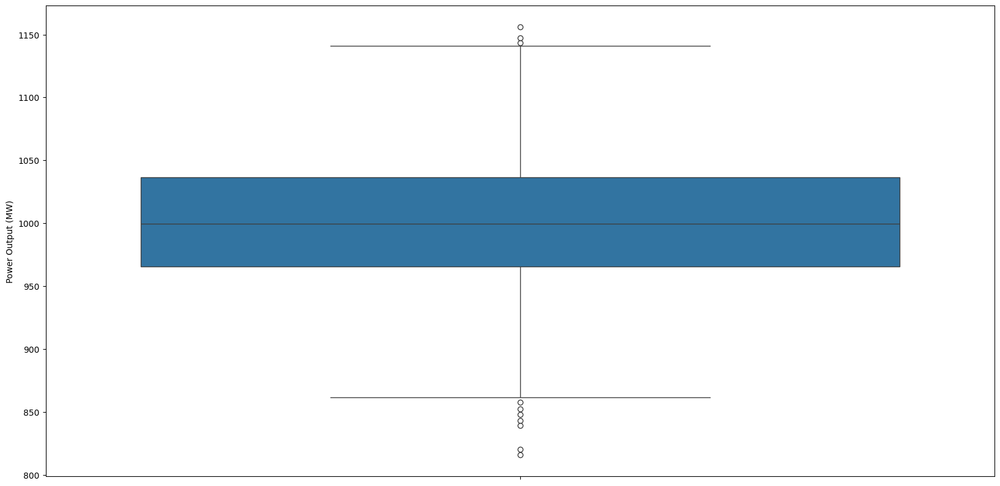

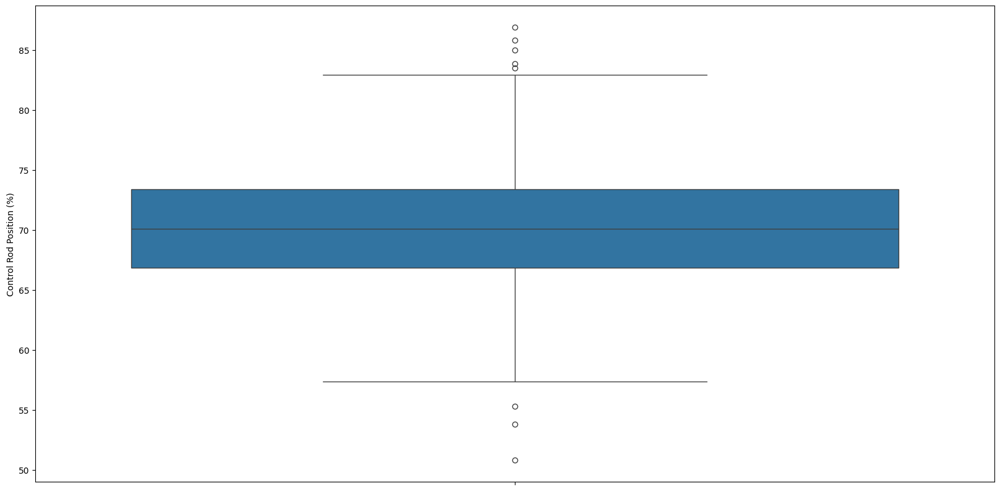

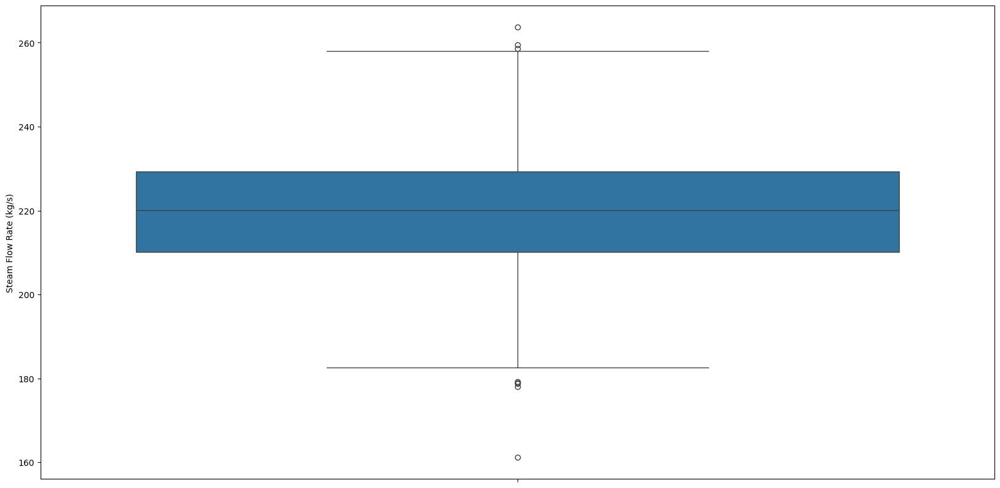

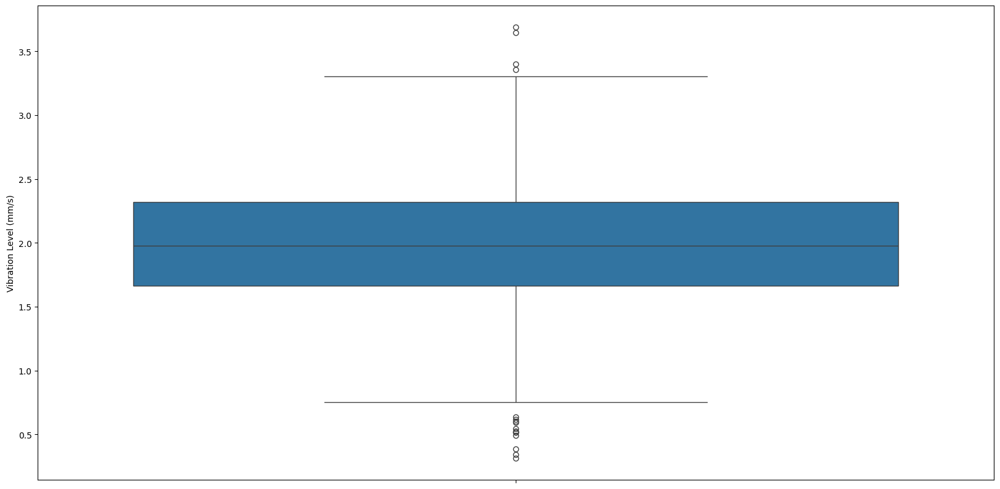

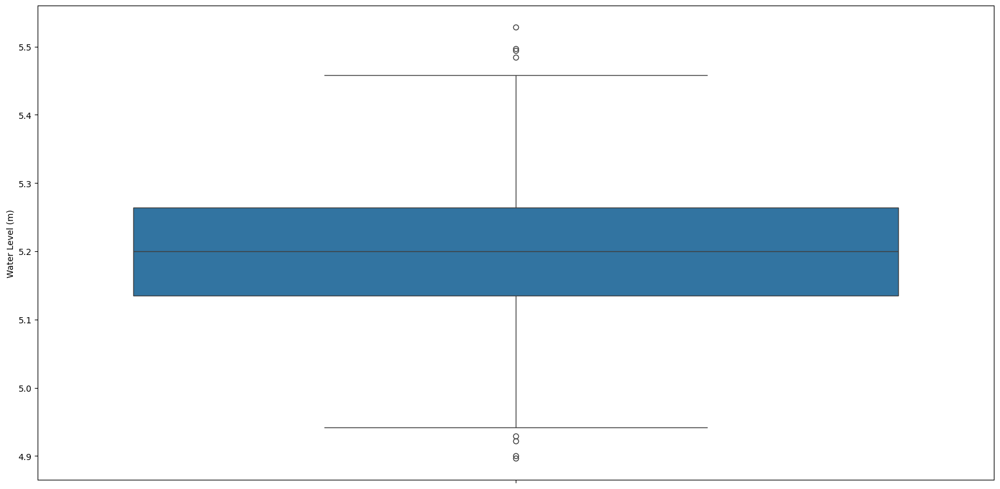

In [20]:
for col in num_col:
  plt.figure(figsize=(20,10))
  sns.boxplot(df[col])
  plt.show()

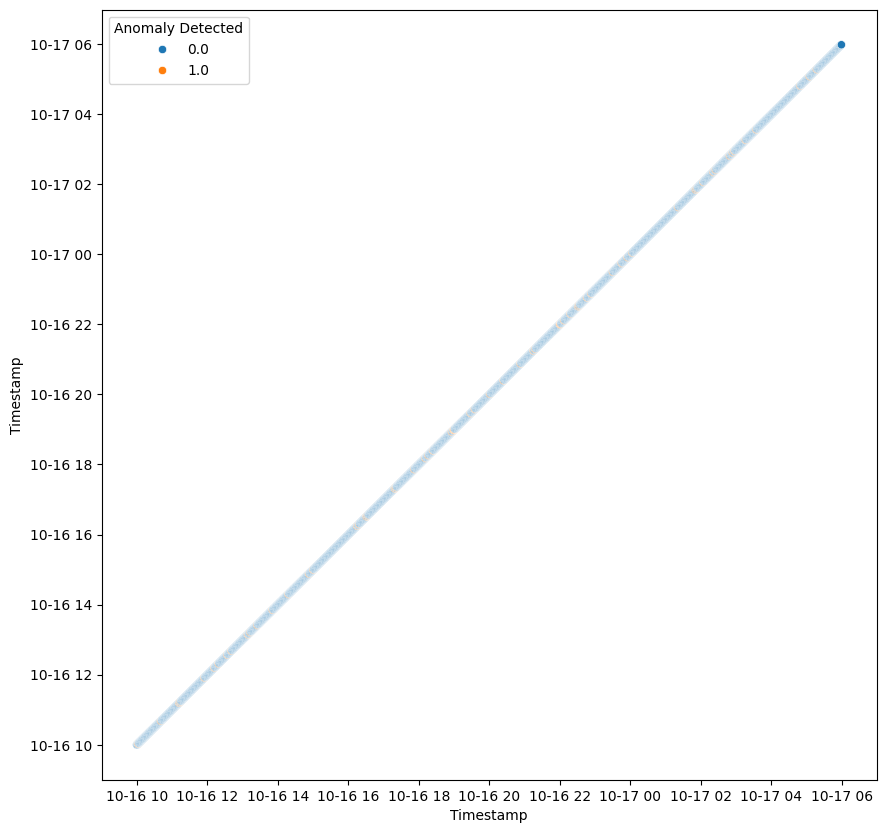

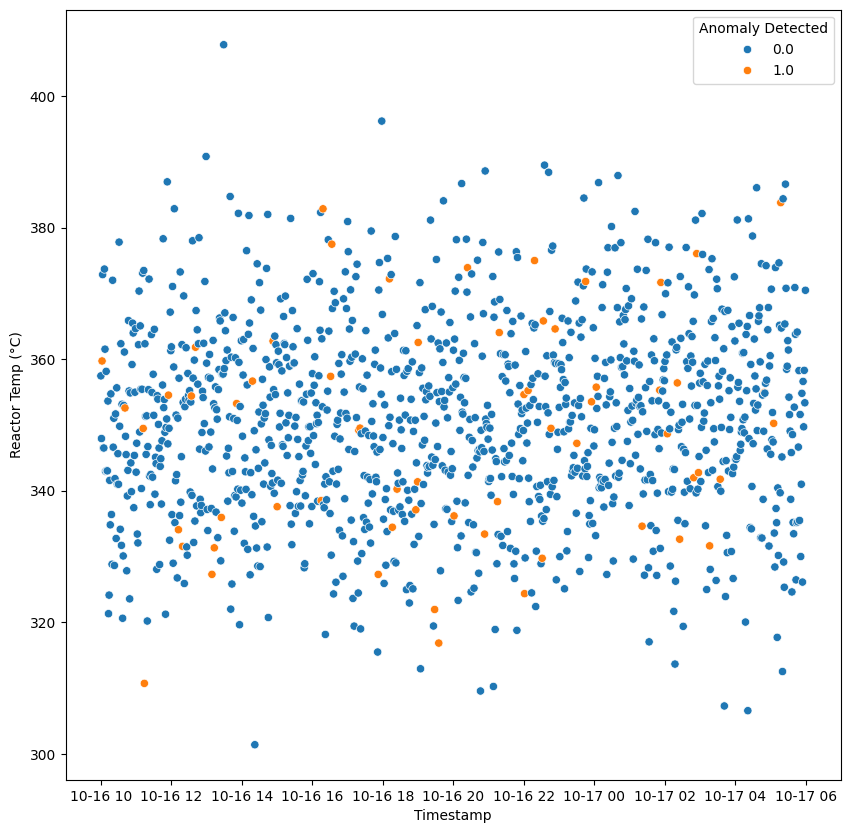

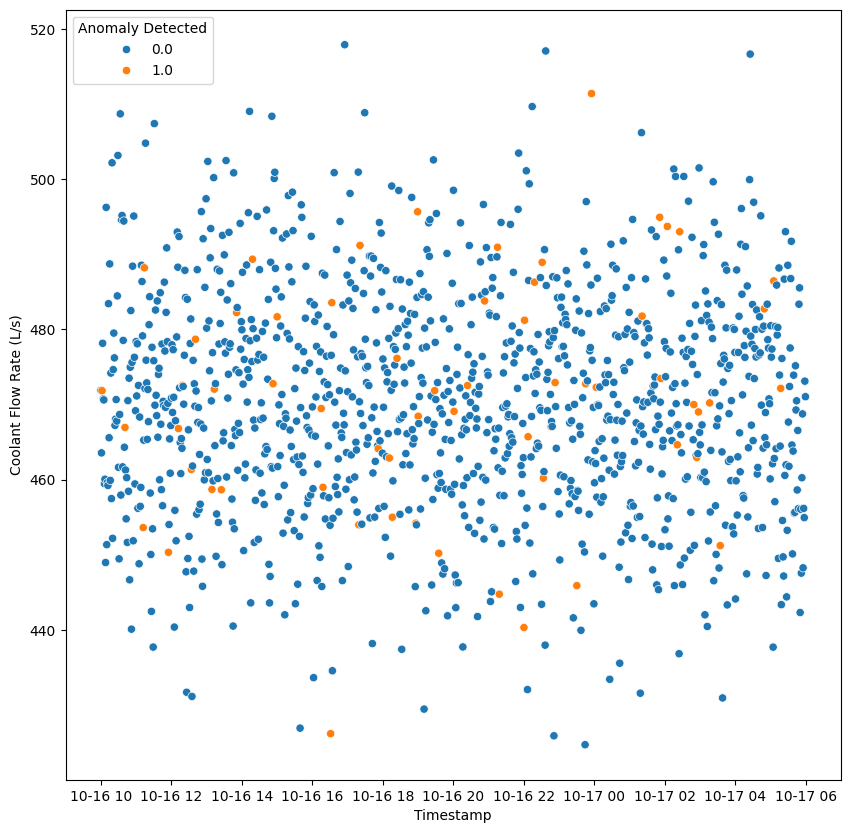

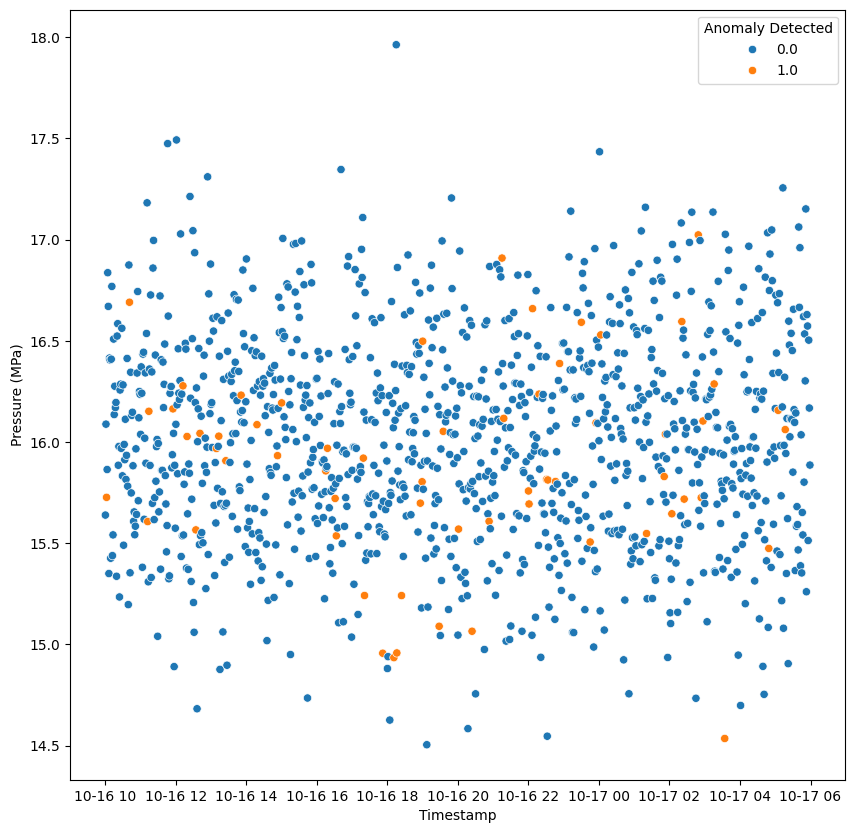

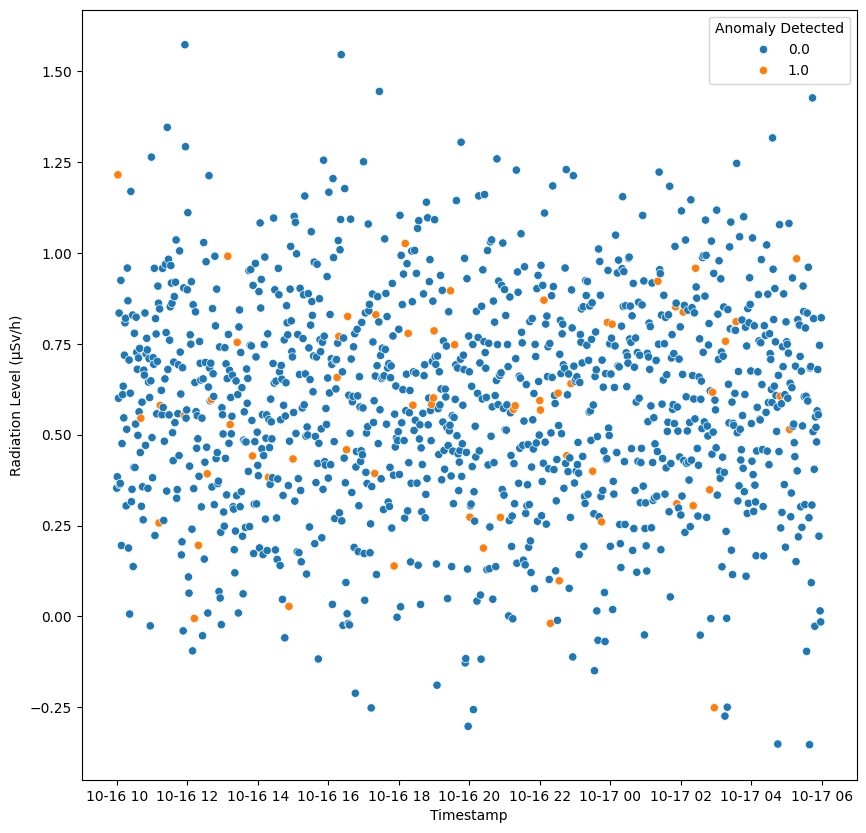

...

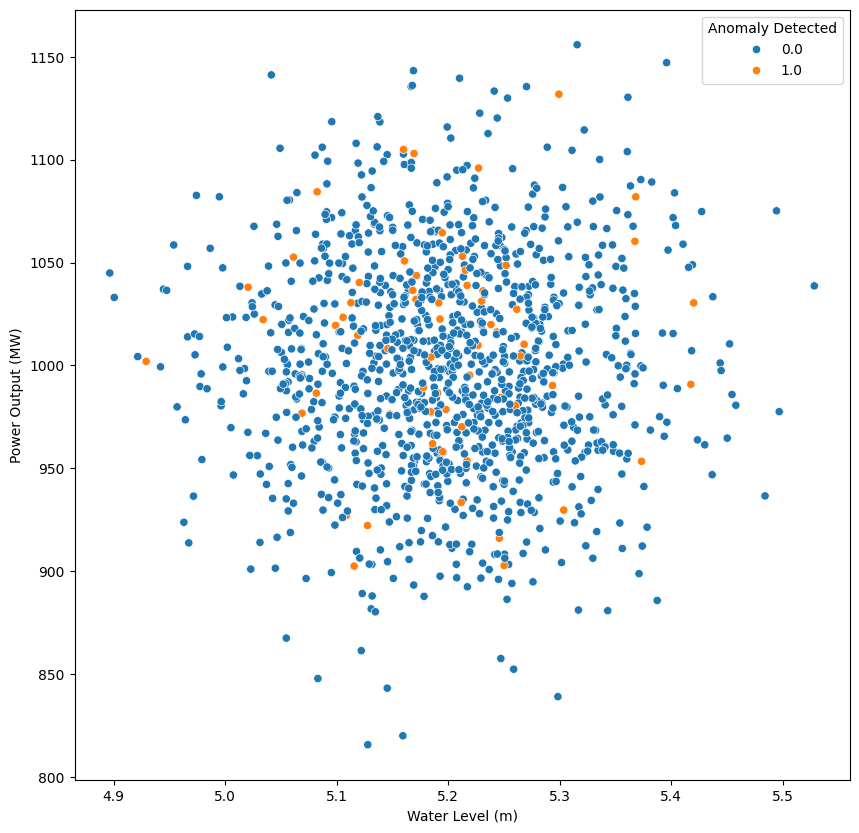

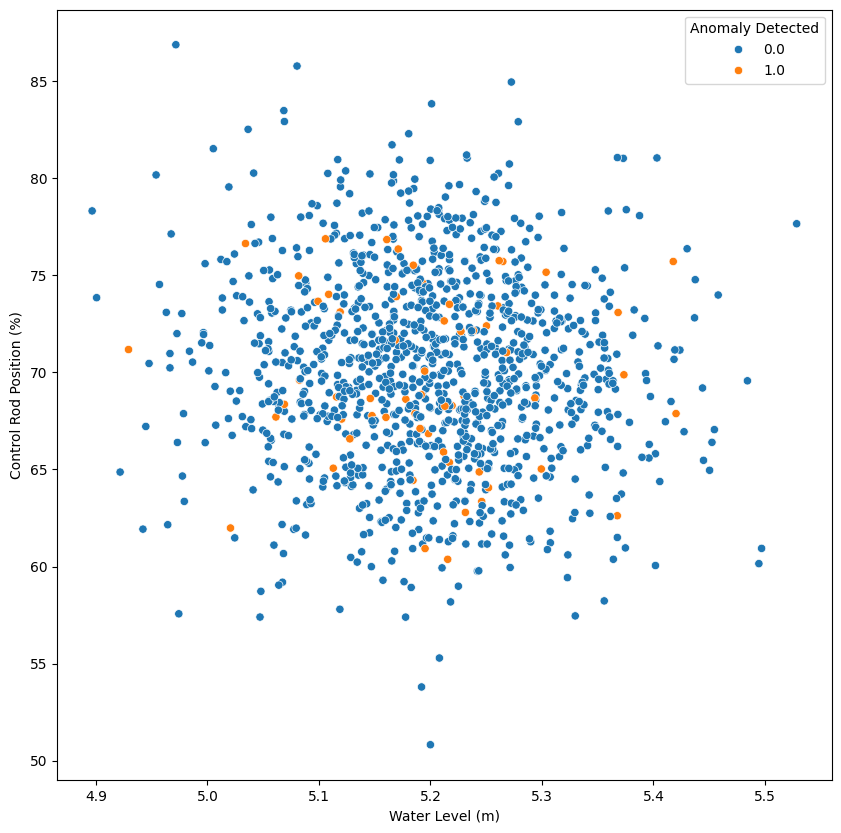

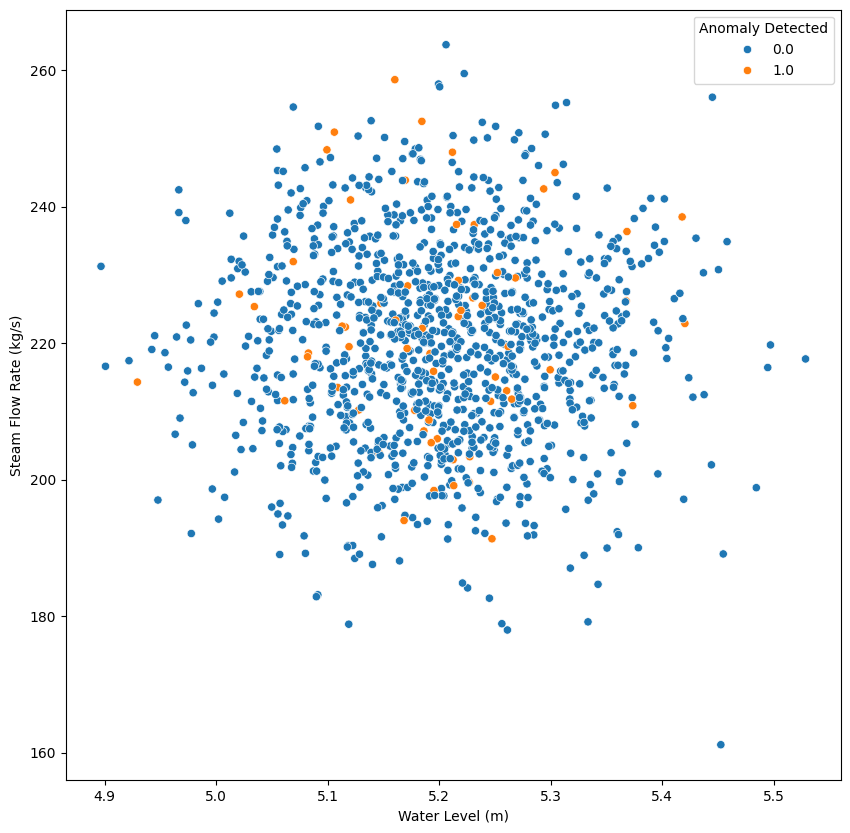

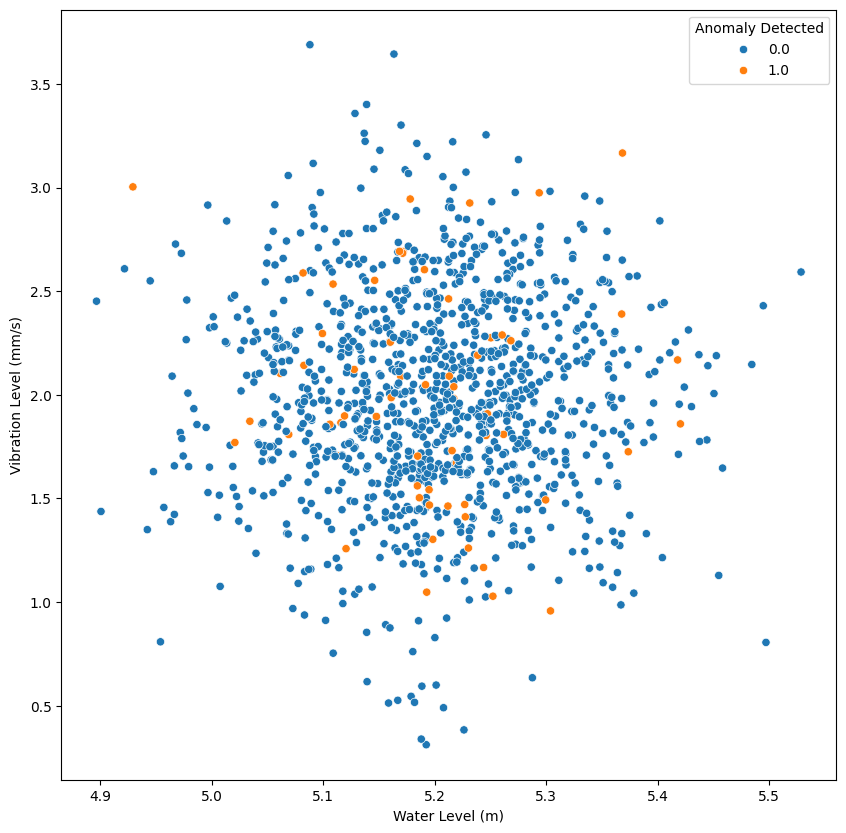

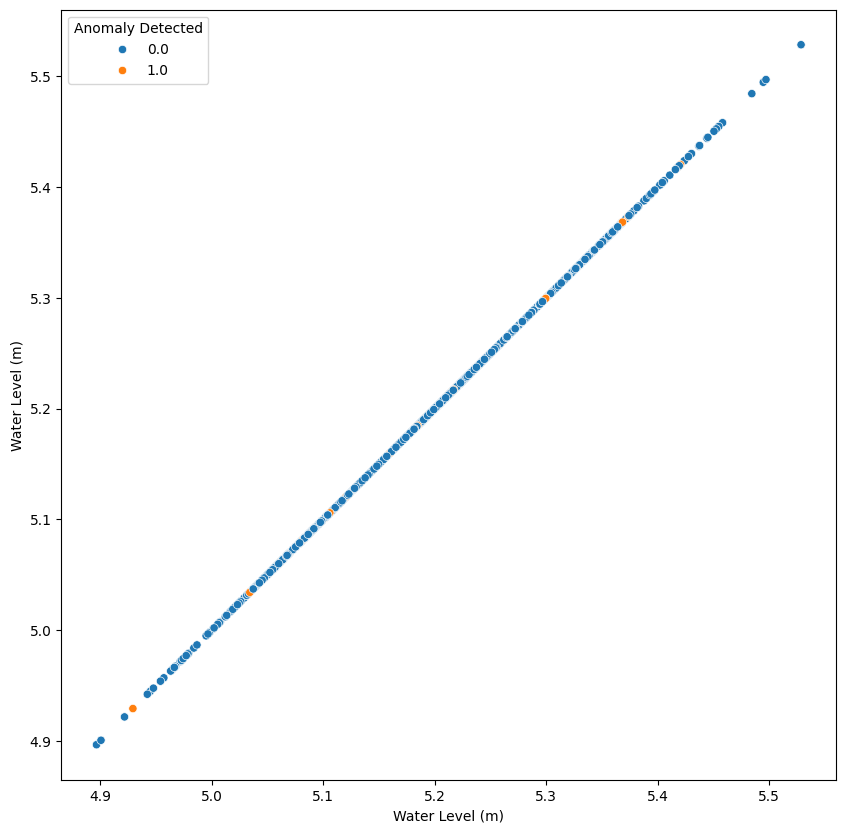

In [21]:
for col in num_col:
  for col2 in num_col:
    fig = plt.figure(figsize=(10,10))
    sns.scatterplot(data=df,x=col,y=col2,hue='Anomaly Detected')
    plt.xlabel(col)
    plt.ylabel(col2)
    plt.show()

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Timestamp                 1200 non-null   datetime64[ns]
 1   Reactor Temp (°C)         1200 non-null   float64       
 2   Coolant Flow Rate (L/s)   1200 non-null   float64       
 3   Pressure (MPa)            1200 non-null   float64       
 4   Radiation Level (μSv/h)   1200 non-null   float64       
 5   Turbine Speed (RPM)       1200 non-null   float64       
 6   Pump Status               1200 non-null   float64       
 7   Power Output (MW)         1200 non-null   float64       
 8   Control Rod Position (%)  1200 non-null   float64       
 9   Steam Flow Rate (kg/s)    1200 non-null   float64       
 10  Vibration Level (mm/s)    1200 non-null   float64       
 11  Water Level (m)           1200 non-null   float64       
 12  Anomaly Detected    

In [31]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

In [28]:
x = df.drop(['Timestamp','Anomaly Detected'],axis=1)
y = df['Anomaly Detected']

In [56]:
from imblearn.over_sampling import RandomOverSampler
from collections import Counter

# X, y = your features and labels
print("Before:", Counter(y))

ros = RandomOverSampler(random_state=42)
X_res, y_res = ros.fit_resample(x, y)

print("After:", Counter(y_res))


Before: Counter({0.0: 1138, 1.0: 62})
After: Counter({0.0: 1138, 1.0: 1138})


In [57]:
X_train,X_test,y_train,y_test = train_test_split(X_res,y_res,test_size= 0.2,random_state=42)

In [58]:
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [59]:
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

In [60]:
svm = SVC(class_weight='balanced')
lr = LogisticRegression(class_weight='balanced')
rf = RandomForestClassifier(class_weight='balanced')
xgb = XGBClassifier(class_weight='balanced')

In [61]:
svm.fit(X_train,y_train)
lr.fit(X_train,y_train)
rf.fit(X_train,y_train)
xgb.fit(X_train,y_train)

/usr/local/lib/python3.12/dist-packages/xgboost/training.py:183: UserWarning: [16:38:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "class_weight" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              class_weight='balanced', colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=None, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, feature_weights=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None, ...)

In [62]:
y_pred_svm = svm.predict(X_test)
y_pred_lr = lr.predict(X_test)
y_pred_rf = rf.predict(X_test)
y_pred_xgb = xgb.predict(X_test)

In [63]:
print(classification_report(y_test,y_pred_svm))

              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94       241
         1.0       0.89      1.00      0.94       215

    accuracy                           0.94       456
   macro avg       0.94      0.94      0.94       456
weighted avg       0.94      0.94      0.94       456



In [64]:
print(classification_report(y_test,y_pred_lr))

              precision    recall  f1-score   support

         0.0       0.60      0.54      0.57       241
         1.0       0.54      0.59      0.56       215

    accuracy                           0.57       456
   macro avg       0.57      0.57      0.57       456
weighted avg       0.57      0.57      0.57       456



In [65]:
print(classification_report(y_test,y_pred_rf))

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       241
         1.0       1.00      1.00      1.00       215

    accuracy                           1.00       456
   macro avg       1.00      1.00      1.00       456
weighted avg       1.00      1.00      1.00       456



In [66]:
print(classification_report(y_test,y_pred_xgb))

              precision    recall  f1-score   support

         0.0       1.00      0.99      1.00       241
         1.0       0.99      1.00      1.00       215

    accuracy                           1.00       456
   macro avg       1.00      1.00      1.00       456
weighted avg       1.00      1.00      1.00       456



In [53]:
!pip install imbalanced-learn



In [67]:
import pickle

In [68]:
with open("model.pkl",'wb') as f:
  pickle.dump(xgb,f)

In [69]:
with open("scaler.pkl",'wb') as f:
  pickle.dump(sc,f)